In [ ]:
import os, sys

from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
#load the module in  a  new notebook
import sys
sys.path.append('/content/gdrive/My Drive/social-networks-utils-main')


In [ ]:
import sys
sys.path.insert(0,'/content/drive/My Drive/social-networks-utils-main')

from metricas import *
from homofilia import *
from modelos import*

In [ ]:
pip install ndlib

In [ ]:
import networkx as nx
import pandas as pd
import ndlib
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import networkx as nx
import ndlib.models.ModelConfig as mc
import ndlib.models.epidemics as ep


df = pd.read_csv("World.csv") #Traigo mi set de datos
# importing sys
import sys
sys.path.insert(0, r"E:\Facultad\TDA II\Untitled Folder\social-networks-utils")

from metricas import *
from modelos import * 

In [ ]:
G = nx.from_pandas_edgelist(df, "Origen", "Destino")
G = nx.to_undirected(G)

Comenzamos realizando simulaciones de grafos G1, G2 aleatorios. Para ello utilizamos parámetros aproximados con el fin de que la simulación sea más visible y clara.

In [ ]:
e_r_25 = erdos_renyi(cant = 1000,k = 25)
p_a_25 = preferential_attachment(dirigido = False,alfa = 2.7  , cant = 1000, k = 25)


Primero graficamos G1

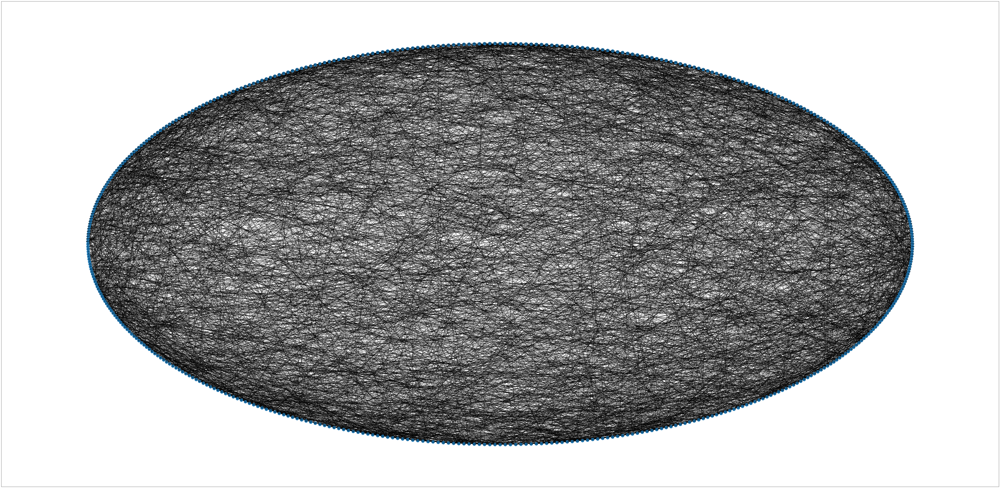

In [ ]:
figure(figsize=(100, 50), dpi=80)
pos_2 = nx.shell_layout(e_r_25)
nx.draw_networkx_nodes(e_r_25, pos_2)
labels = nx.draw_networkx_labels(e_r_25, pos_2)
edges = nx.draw_networkx_edges(e_r_25,pos_2)

Luego, graficamos G2

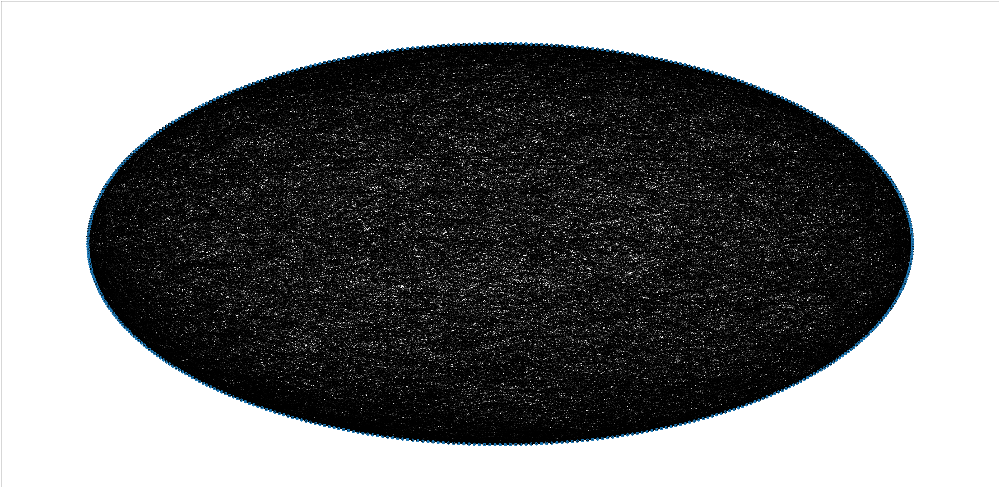

In [ ]:
figure(figsize=(20, 10), dpi=80)
pos_2 = nx.shell_layout(p_a)
nx.draw_networkx_nodes(p_a, pos_2)
labels = nx.draw_networkx_labels(p_a, pos_2)
edges = nx.draw_networkx_edges(p_a,pos_2)

Comparando los dos gráficos se puede ver claramente como G1 es menos denso de aristas que G2. 

Modelamos los grafos aleatorios.
G1 = e_r
G2 = p_a

In [ ]:
e_r = erdos_renyi(cant = 1000,k = grado_promedio(G))
p_a = preferential_attachment(dirigido = False,alfa = 2.7  , cant = 1000, k = grado_promedio(G))


Aplicamos el Modelo SIR.

In [ ]:
# Model selection
model = ep.SIRModel(e_r)

# Model Configuration
cfg = mc.Configuration()
cfg.add_model_parameter('beta', 0.01)
cfg.add_model_parameter('gamma', 0.005)
cfg.add_model_parameter("fraction_infected", 1/1000)#se comienza con un solo infectado
model.set_initial_status(cfg)

# Simulation execution
iterations_e_r = model.iteration_bunch(50)

In [ ]:
for i in iterations_e_r:
  if i['node_count'][1] > 300:
    print("En la iteración {}{} supera el 30% de infectados".format(i['iteration'],i['node_count']))
    
    break    
  # en la it 29

En la iteración 29{0: 680, 1: 309, 2: 11} supera el 30% de infectados


In [ ]:
# Model selection
model = ep.SIRModel(p_a)

# Model Configuration
cfg = mc.Configuration()
cfg.add_model_parameter('beta', 0.01)
cfg.add_model_parameter('gamma', 0.005)
cfg.add_model_parameter("fraction_infected", 1/1000)#se comienza con un solo infectado
model.set_initial_status(cfg)

# Simulation execution
iterations_p_a = model.iteration_bunch(50)

In [ ]:
for i in iterations_p_a:
     if i['node_count'][1] > 300:
        print("En la iteración {}{} supera el 30% de infectados".format(i['iteration'],i['node_count']))

        break  

En la iteración 13{0: 662, 1: 336, 2: 2} supera el 30% de infectados


En conclusión obtenemos que en el grafo G1 se tardan 29 iteraciones hasta llegar al 30% de infectados. Mientras que para la simulación con G2 el 30% de contagios sucede en la iteración 13.

### 4.b Virus comienza en el nodo de mayor grado.

#### Primero calculamos para G1 cuál es el nodo con mayor grado.

---------------------------------------------------------------------

In [ ]:
max_k_node_e_r = sorted(list(e_r.degree), key = lambda x: -x[1])[0][0]
max_k_node_e_r

674

Nuevamente, simulamos con este nuevo valor.

In [ ]:
# Model selection
model = ep.SIRModel(p_a)

# Model Configuration
cfg = mc.Configuration()
cfg.add_model_parameter('beta', 0.01)
cfg.add_model_parameter('gamma', 0.005)
cfg.add_model_parameter("fraction_infected", 0)
cfg.add_model_initial_configuration("Infected", [max_k_node_e_r])
model.set_initial_status(cfg)

# Simulation execution
iterations_e_r_max = model.iteration_bunch(50)

In [ ]:
for i in iterations_e_r_max:
  if i['node_count'][1] > 300:
    print("En la iteración {}{} supera el 30% de infectados".format(i['iteration'],i['node_count']))
    
    break    
 

En la iteración 15{0: 629, 1: 370, 2: 1} supera el 30% de infectados


### Ahora calculamos para G2 cuál es el nodo con mayor grado.

In [ ]:
max_k_node_p_a = sorted(list(p_a.degree), key = lambda x: -x[1])[0][0]
max_k_node_p_a

4

Y simulamos con este nuevo valor.

In [ ]:
# Model selection
model = ep.SIRModel(p_a)

# Model Configuration
cfg = mc.Configuration()
cfg.add_model_parameter('beta', 0.01)
cfg.add_model_parameter('gamma', 0.005)
cfg.add_model_parameter("fraction_infected", 0)
cfg.add_model_initial_configuration("Infected", [max_k_node_p_a])
model.set_initial_status(cfg)

# Simulation execution
iterations_p_a_max = model.iteration_bunch(50)

In [ ]:
for i in iterations_p_a_max:
  if i['node_count'][1] > 300:
    print("En la iteración {}{} supera el 30% de infectados".format(i['iteration'],i['node_count']))
    
    break    


En la iteración 11{0: 599, 1: 399, 2: 2} supera el 30% de infectados


Finalmente, en estas nuevas simulaciones obtenemos que el grafo G2 se mantiene siendo el grafo por el cual más rápido se propaga la enfermedad (se llega antes al 30% de infectados). Pero aún asi podemos notar ciertas diferencias con la anterior simulación.
En el caso de G1, la cantidad de iteraciones hasta llegar al 30% mejora significativamente: antes eran 29 iteraciones mientras que en esta nueva simulación, se necesitaron tan solo 15, es decir, se redujo poco más de la mitad.
Por otro lado, no se observan mayores cambios en cuanto al grafo G2, en la primera simulación se necesitaron 13 iteraciones y en la nueva simulación 11 iteraciones. Esto es de alguna manera esperable, ya que en el caso de G2, la distribución de los nodos es más pareja que en el caso de G1. 

In [1]:
#Utilizo el siguiente código para generar un pdf con la resolucion.

!wget -nc https://raw.githubusercontent.com/brpy/colab-pdf/master/colab_pdf.py
from colab_pdf import colab_pdf
colab_pdf('Simulaciones-P3-TDA2.ipynb')

--2022-07-15 22:18:17--  https://raw.githubusercontent.com/brpy/colab-pdf/master/colab_pdf.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1864 (1.8K) [text/plain]
Saving to: ‘colab_pdf.py’

colab_pdf.py        100%[===================>]   1.82K  --.-KB/s    in 0s      

2022-07-15 22:18:17 (23.2 MB/s) - ‘colab_pdf.py’ saved [1864/1864]

Mounted at /content/drive/




Extracting templates from packages: 100%
[NbConvertApp] Converting notebook /content/drive/MyDrive/Colab Notebooks/Simulaciones-P3-TDA2.ipynb to pdf
[NbConvertApp] Writing 43908 bytes to ./notebook.tex
[NbConvertApp] Building PDF
[NbConvertApp] Running xelatex 3 times: ['xelatex', './notebook.tex', '-quiet']
[NbConvertApp] Running bibtex 1 time: ['bibtex', './notebook']
[NbConvertApp] WARNIN

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

'File ready to be Downloaded and Saved to Drive'